# End-to-end Multi-class Dog Breed Classification

## 1. Problem

Identifying the breed of a dog by giving an image of a dog.

## 2. Data

Used data : https://www.kaggle.com/competitions/dog-breed-identification/data

## 3. Evaluation

The evaluation is a file with prediction probabilities for each dog breed of each test image.

## 4. Features

There are 120 breeds of dogs so we have 120 different classes.

There are around 10000 images in the training set and in the testing set.

In [ ]:
#!unzip "/content/drive/MyDrive/Dog Detection/dog-breed-identification.zip" -d "/content/drive/MyDrive/Dog Detection/"

In [1]:
# Import necessary tools
import tensorflow as tf
import tensorflow_hub as hub
print("TF version:", tf.__version__)
print("TF Hub version:", hub.__version__)

# Check for GPU availability
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available")

TF version: 2.11.0
TF Hub version: 0.12.0
GPU available


## Getting our data ready

In [2]:
import pandas as pd
labels_csv = pd.read_csv("/content/drive/MyDrive/Dog Detection/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


<AxesSubplot:>

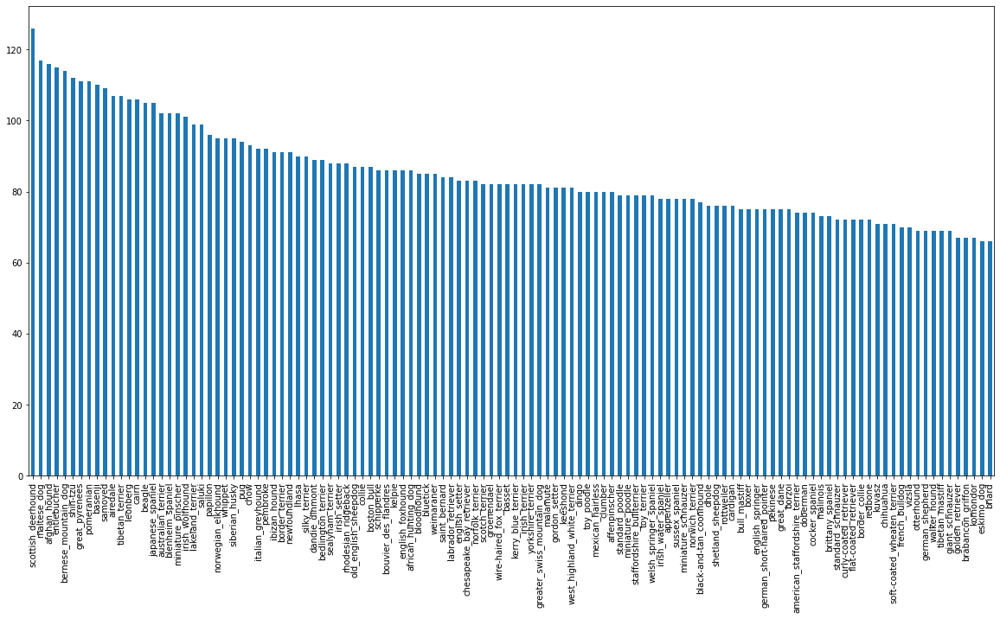

In [3]:
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10))

In [4]:
labels_csv["breed"].value_counts().median()

82.0

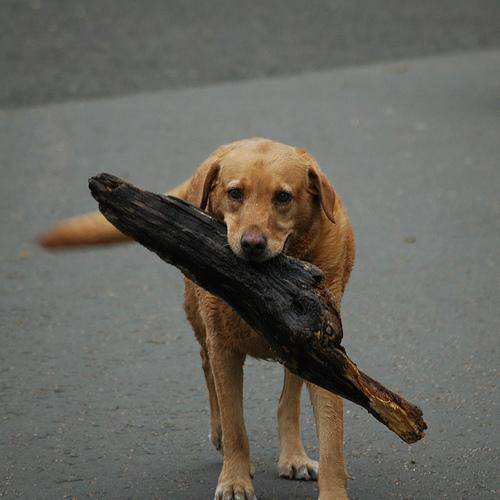

In [5]:
from IPython.display import Image
Image("drive/MyDrive/Dog Detection/train/0021f9ceb3235effd7fcde7f7538ed62.jpg")

### Getting images and their labels

In [6]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [7]:
filenames = [ "drive/MyDrive/Dog Detection/train/" + fname + ".jpg" for fname in labels_csv["id"]]

filenames[:10]

['drive/MyDrive/Dog Detection/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog Detection/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog Detection/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog Detection/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog Detection/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog Detection/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog Detection/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog Detection/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog Detection/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog Detection/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [8]:
import os
if len(os.listdir("drive/MyDrive/Dog Detection/train/")) == len(filenames):
  print("Filenames match actual amount of files")
else:
  print("Files do not match actualy amount of files, check the target directory.")

Filenames match actual amount of files


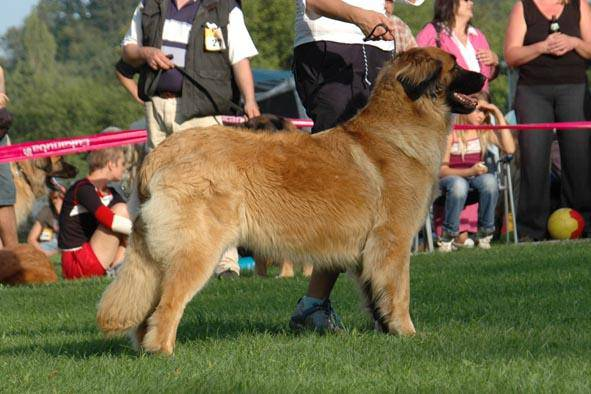

In [9]:
Image(filenames[111])

In [10]:
import numpy as np
labels = labels_csv["breed"]
labels = np.array(labels)
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [11]:
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames")
else:
  print("Number of labels does not match number of filenames, check data directories")
  

Number of labels matches number of filenames


In [12]:
unique_breeds =np.unique(labels)
len(unique_breeds)

120

In [13]:
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

 ### Creating validation set

In [14]:
X = filenames
y = boolean_labels

In [15]:
NUM_IMAGES = 1000 #@param{type:"slider", min:1000, max:10000, step:1000}

In [16]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [17]:
X_train[:2], y_train[:2]

(['drive/MyDrive/Dog Detection/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/Dog Detection/train/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, Fals

## Preprocessing Images (turning images into Tensors)

In [18]:
IMG_SIZE =224

def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels=3)
  image = tf.image.convert_image_dtype(image, tf.float32)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

## Turning our data into batches

In [19]:
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image,label

In [20]:
BATCH_SIZE = 32

def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) 
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), 
                                               tf.constant(y))) 
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), 
                                              tf.constant(y))) 
    
    data = data.shuffle(buffer_size=len(x))

    data = data.map(get_image_label)

    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [21]:
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data = True)

Creating training data batches...
Creating validation data batches...


In [22]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches

In [23]:
import matplotlib.pyplot as plt

def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  plt.figure(figsize=(10, 10))
  for i in range(25):
    ax = plt.subplot(5, 5, i+1)
    plt.imshow(images[i])
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis("off")

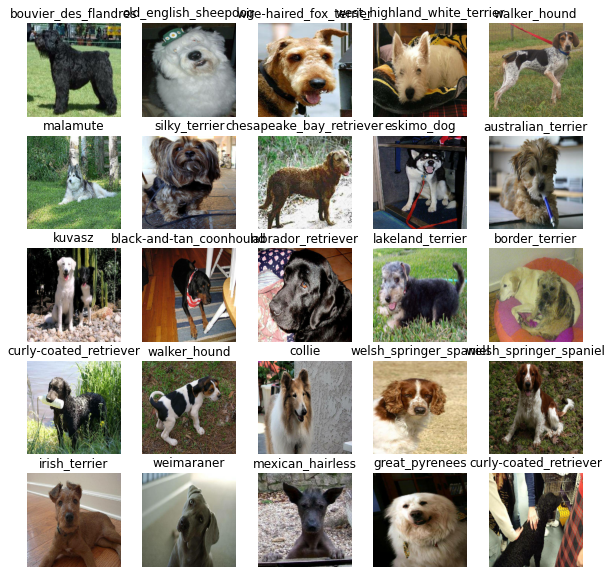

In [24]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

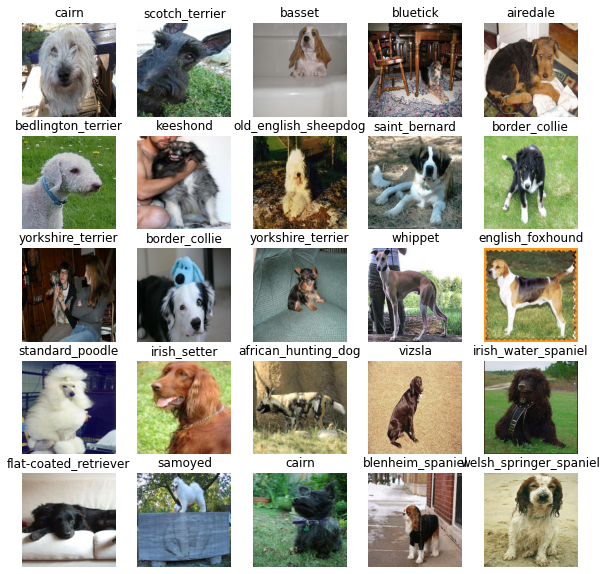

In [25]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Creating and training a model

In [26]:
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] 

OUTPUT_SHAPE = len(unique_breeds) 

MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [27]:
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), 
    tf.keras.layers.Dense(units=OUTPUT_SHAPE, 
                          activation="softmax")
  ])

  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), 
      optimizer=tf.keras.optimizers.Adam(), 
      metrics=["accuracy"] 
  )

  model.build(INPUT_SHAPE) 
  
  return model

In [28]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating callbacks

In [29]:
%load_ext tensorboard

In [30]:
import datetime

def create_tensorboard_callback():
  logdir = os.path.join("drive/My Drive/Data/logs",
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

## Early Stopping Callback

In [31]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

## Training a model (on a subset of data)

In [32]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [33]:
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  model = create_model()

  tensorboard = create_tensorboard_callback()

  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1, 
            callbacks=[tensorboard, early_stopping])
  
  return model

In [34]:
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 90s 3s/step - loss: 4.7621 - accuracy: 0.0812 - val_loss: 3.4765 - val_accuracy: 0.2600
Epoch 2/100
25/25 [==============================] - 4s 141ms/step - loss: 1.7324 - accuracy: 0.6612 - val_loss: 2.1516 - val_accuracy: 0.5050
Epoch 3/100
25/25 [==============================] - 3s 117ms/step - loss: 0.6026 - accuracy: 0.9388 - val_loss: 1.6808 - val_accuracy: 0.5850
Epoch 4/100
25/25 [==============================] - 4s 170ms/step - loss: 0.2691 - accuracy: 0.9825 - val_loss: 1.4806 - val_accuracy: 0.6300
Epoch 5/100
25/25 [==============================] - 4s 145ms/step - loss: 0.1569 - accuracy: 0.9925 - val_loss: 1.3906 - val_accuracy: 0.6400
Epoch 6/100
25/25 [==============================] - 3s 119ms/step - loss: 0.1064 - accuracy: 0.9987 - val_loss: 1.3462 - val_accuracy: 0.6550
Epoch 7/100
25/25 [==============================] 

In [35]:
%tensorboard --logdir drive/MyDrive/Data/logs

<IPython.core.display.Javascript object>

## Making and evaluating predictions using a trained model

In [36]:
predictions = model.predict(val_data, verbose=1) 
predictions

7/7 [==============================] - 8s 91ms/step


array([[5.5086338e-03, 2.6546229e-05, 5.9763098e-04, ..., 7.0480618e-04,
        7.6105382e-05, 3.7637104e-03],
       [5.7863479e-04, 5.0902669e-04, 3.8378127e-02, ..., 6.3346681e-04,
        1.8345105e-03, 6.3380212e-05],
       [1.1177869e-05, 4.8120278e-06, 6.9271323e-06, ..., 6.6353408e-05,
        3.2695210e-05, 1.3280881e-04],
       ...,
       [9.7548982e-05, 9.7094751e-05, 2.6910644e-04, ..., 5.7184599e-05,
        2.0796779e-04, 2.1500220e-04],
       [2.6962187e-03, 2.3933836e-04, 7.5831078e-05, ..., 2.6868444e-04,
        1.1974368e-04, 2.8717654e-02],
       [1.8460046e-04, 1.0872789e-04, 1.1140438e-03, ..., 3.0283541e-03,
        5.3247262e-04, 1.1229926e-04]], dtype=float32)

In [37]:
predictions.shape

(200, 120)

In [38]:
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") 
print(f"Sum: {np.sum(predictions[0])}") 
print(f"Max index: {np.argmax(predictions[0])}") 
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") 

[5.50863380e-03 2.65462295e-05 5.97630977e-04 3.41453473e-04
 6.64423278e-04 1.91286126e-05 7.95668084e-03 9.09511989e-04
 2.95434729e-04 2.49849516e-03 6.10115414e-04 8.07062665e-04
 7.37376628e-04 4.55610279e-05 1.29296866e-04 3.38451704e-04
 1.47230612e-05 1.94088086e-01 1.34440752e-05 1.48647014e-04
 3.52586620e-04 1.73939436e-04 7.89396654e-05 1.88292400e-03
 8.87385977e-05 3.07156501e-04 1.00036025e-01 9.14312113e-05
 5.33726939e-04 8.48308322e-04 7.05608472e-05 9.06065456e-04
 3.86638829e-04 3.36979465e-05 2.37498549e-04 2.44440362e-02
 8.35329774e-05 2.09723890e-04 2.04469499e-04 1.83438184e-04
 3.55247827e-03 6.95447889e-05 7.90193211e-04 5.87808645e-05
 1.11410343e-04 5.85162525e-05 2.46388099e-05 3.65790940e-04
 4.07617888e-04 2.67623080e-04 2.96520739e-05 2.48243363e-04
 4.09558997e-04 6.94557093e-05 1.98582275e-04 1.43518380e-04
 7.44974750e-05 5.98810799e-03 4.18721378e-04 2.99334168e-01
 1.15439540e-03 1.03966049e-05 1.40563748e-03 1.60395008e-04
 5.10343525e-04 7.408517

In [39]:
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

pred_label = get_pred_label(predictions[0])
pred_label

'irish_wolfhound'

In [40]:
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []

  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [41]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  
  pred_label = get_pred_label(pred_prob)
  
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

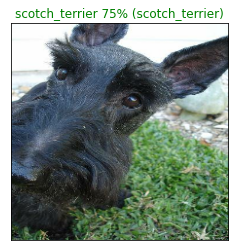

In [42]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

In [49]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  pred_label = get_pred_label(pred_prob)

  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

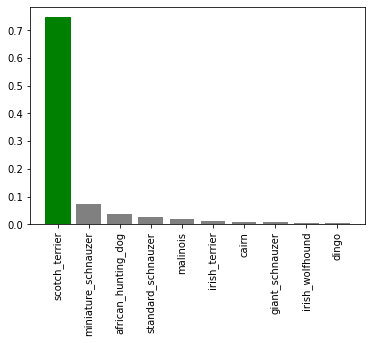

In [50]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=1)

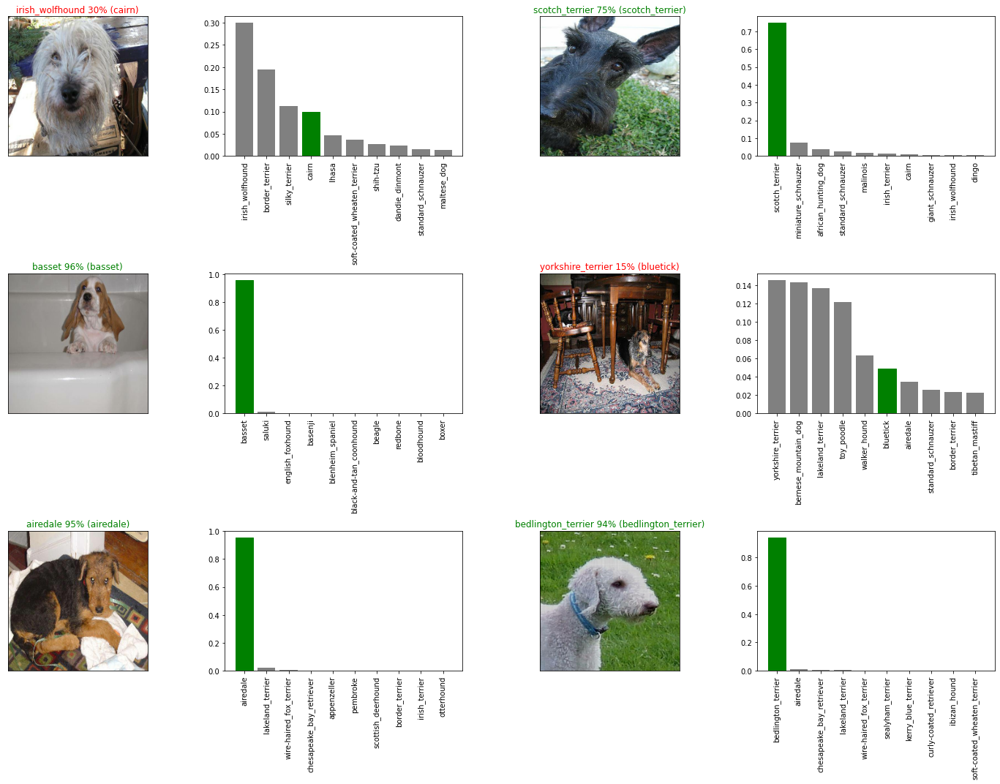

In [51]:
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and reloading a model

In [52]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  modeldir = os.path.join("drive/MyDrive/Data/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5"
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [53]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [54]:
save_model(model, suffix="1000-images-Adam")

Saving model to: drive/MyDrive/Data/models/20230227-12571677502627-1000-images-Adam.h5...


'drive/MyDrive/Data/models/20230227-12571677502627-1000-images-Adam.h5'

In [57]:
model_1000_images = load_model('drive/MyDrive/Data/models/20230227-12571677502627-1000-images-Adam.h5')

Loading saved model from: drive/MyDrive/Data/models/20230227-12571677502627-1000-images-Adam.h5


In [58]:
model.evaluate(val_data)

7/7 [==============================] - 2s 204ms/step - loss: 1.2792 - accuracy: 0.6500


[1.2791953086853027, 0.6499999761581421]

In [59]:
model_1000_images.evaluate(val_data)

7/7 [==============================] - 3s 197ms/step - loss: 1.2792 - accuracy: 0.6500


[1.2791953086853027, 0.6499999761581421]

## Training a model (on the full data)

In [60]:
len(X), len(y)

(10222, 10222)

In [61]:
full_data = create_data_batches(X, y)

Creating training data batches...


In [62]:
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [63]:
full_model_tensorboard = create_tensorboard_callback()

full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [64]:
%tensorboard --logdir drive/MyDrive/Data/logs

Reusing TensorBoard on port 6006 (pid 3381), started 0:15:18 ago. (Use '!kill 3381' to kill it.)

<IPython.core.display.Javascript object>

In [65]:
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 912s 3s/step - loss: 1.2987 - accuracy: 0.6787
Epoch 2/100
320/320 [==============================] - 35s 110ms/step - loss: 0.3982 - accuracy: 0.8841
Epoch 3/100
320/320 [==============================] - 33s 102ms/step - loss: 0.2304 - accuracy: 0.9399
Epoch 4/100
320/320 [==============================] - 33s 102ms/step - loss: 0.1570 - accuracy: 0.9612
Epoch 5/100
320/320 [==============================] - 32s 101ms/step - loss: 0.1045 - accuracy: 0.9789
Epoch 6/100
320/320 [==============================] - 33s 102ms/step - loss: 0.0758 - accuracy: 0.9864
Epoch 7/100
320/320 [==============================] - 33s 104ms/step - loss: 0.0585 - accuracy: 0.9910
Epoch 8/100
320/320 [==============================] - 34s 105ms/step - loss: 0.0456 - accuracy: 0.9944
Epoch 9/100
320/320 [==============================] - 33s 103ms/step - loss: 0.0379 - accuracy: 0.9953
Epoch 10/100
320/320 [==============================] - 33s 103ms/

In [66]:
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/MyDrive/Data/models/20230227-13341677504875-all-images-Adam.h5...


'drive/MyDrive/Data/models/20230227-13341677504875-all-images-Adam.h5'

In [67]:
loaded_full_model = load_model('drive/MyDrive/Data/models/20230227-13341677504875-all-images-Adam.h5')

Loading saved model from: drive/MyDrive/Data/models/20230227-13341677504875-all-images-Adam.h5


In [70]:
test_path = "drive/MyDrive/Dog Detection/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['drive/MyDrive/Dog Detection/test/df577444ba8b7733f42c49e9d42111a9.jpg',
 'drive/MyDrive/Dog Detection/test/e292584f17fa7cea7f95bdadecde0ebb.jpg',
 'drive/MyDrive/Dog Detection/test/dca9642123204fd3df080147b05e4af3.jpg',
 'drive/MyDrive/Dog Detection/test/e23ad195d88975333bbcde7dce5faf01.jpg',
 'drive/MyDrive/Dog Detection/test/e278b2f68fa5d146e0bf06eee5faa0e3.jpg',
 'drive/MyDrive/Dog Detection/test/debfa5cad80e35c510dff6ca29b94ca3.jpg',
 'drive/MyDrive/Dog Detection/test/df621265607ba0285bd79705eb3541e0.jpg',
 'drive/MyDrive/Dog Detection/test/df645ae75554d4d7130bfa1b72be53ce.jpg',
 'drive/MyDrive/Dog Detection/test/de3fbd6fb5444fcf14390ac90545c2f1.jpg',
 'drive/MyDrive/Dog Detection/test/dcd6ca546a353654a136431e6fa70972.jpg']

In [76]:
len(test_filenames)

10357

In [72]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [73]:
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 1018s 3s/step


In [75]:
np.savetxt("drive/MyDrive/Dog Detection/preds_array.csv",test_predictions, delimiter=",")

In [77]:
test_predictions.shape

(10357, 120)

In [78]:
test_predictions[:10]

array([[1.3816883e-07, 3.4917991e-14, 1.3321022e-13, ..., 4.4037124e-14,
        5.6584033e-11, 9.1543743e-12],
       [1.4568419e-06, 3.3758372e-09, 9.1038203e-08, ..., 1.4591679e-12,
        2.5200444e-07, 1.6066767e-09],
       [5.2314980e-12, 2.6861628e-06, 2.6180783e-12, ..., 4.8257175e-12,
        2.3232347e-12, 6.2291682e-12],
       ...,
       [6.0305982e-09, 4.1785939e-10, 6.0189315e-10, ..., 1.0339323e-08,
        2.4676837e-13, 3.4616359e-12],
       [4.2017511e-11, 7.7360807e-14, 3.8078343e-12, ..., 1.1301056e-05,
        1.5987267e-12, 2.6894628e-12],
       [3.4930359e-03, 8.5463244e-06, 3.0424173e-05, ..., 1.7098785e-07,
        1.3486207e-05, 1.4445874e-04]], dtype=float32)

## Making predictions on custom images

In [79]:
custom_path = "drive/My Drive/Data/dogs/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [80]:
custom_data = create_data_batches(custom_image_paths, test_data=True)

Creating test data batches...


In [81]:
custom_preds = loaded_full_model.predict(custom_data)

1/1 [==============================] - 1s 770ms/step


In [82]:
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['siberian_husky', 'great_dane', 'pug']

In [83]:
custom_images = []
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

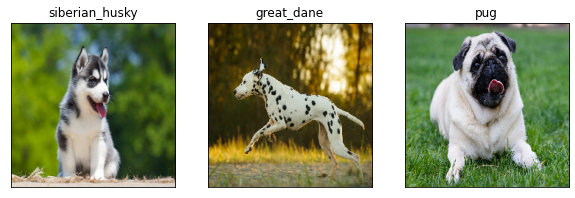

In [84]:
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)